In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import sympy as sy
import math
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
v0x= 0
v0y=0
x0=0
y0=0.1
g=9.81
m=1

In [2]:
N=1000
tfinal=2.7
xt= np.empty(N)
yt= np.empty(N)
xt[0]=x0
yt[0]=y0
vxt= np.empty(N)
vxt[0]=v0x
dt=tfinal/N
epi = m*g*yt[0]
ep = np.empty(N-1)
ep[0] = epi
ec = np.empty(N-1)
ec[0]=0
predictedvf = math.sqrt((epi*2)/m)
t = np.empty(N-1)

In [3]:
def euler():
    for i in range(N-1):
        xt[i+1]=xt[i]+vxt[i]*dt

        

        if xt[i+1]<2:
            yt[i+1]=(0.025*(xt[i+1]-2)**2)
            ax=-g*0.05*(xt[i+1]-2)
        else:
            yt[i+1]=0
            ax=0
        
        vxt[i+1]=vxt[i]+ax*dt
        
        if(xt[i+1]>2.5 and xt[i]<2.5):
            tf = ((2*i+1)/2)*dt
            vtf = vxt[i+1]
            print(tf, vtf)
        if i!=N-1:
            ep[i] = m*g*yt[i]
            ec[i] = 0.5*m*(vxt[i])**2
            t[i] = i*dt
        
    return vtf
vtf = euler()

2.6014500000000003 1.40071448170205


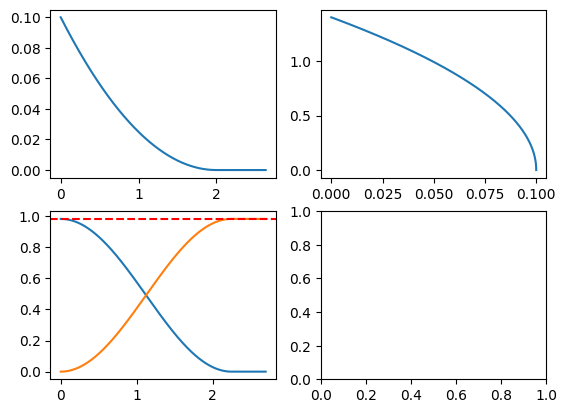

In [4]:
figure, axis = plt.subplots(2,2)
axis[0,0].plot(xt, yt, linestyle="-")
axis[0,1].plot(yt, vxt, linestyle="-")
axis[1,0].plot(t, ep, linestyle="-")
axis[1,0].plot(t, ec, linestyle="-")
axis[1,0].axhline(y=epi, color='r', linestyle='--')

In [5]:
print("Predicted final velocity =" + str(predictedvf) + "\nModel final velocity =" + str(vtf))

Predicted final velocity =1.4007141035914503
Model final velocity =1.40071448170205


Animation size has reached 20973717 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


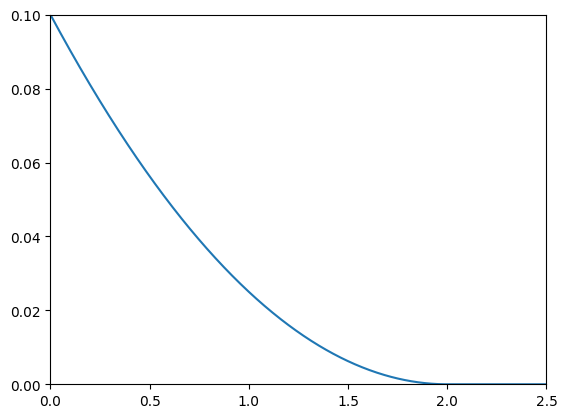

In [6]:
fig, ax = plt.subplots() #criar figura
ax.plot(xt, yt, linestyle="-")
bola = ax.plot(xt[0],yt[0],'o')[0] #terra, posição inicial
ax.set(xlim=[0, 2.5], ylim=[0, 0.1]) #fixar os limites dos eixos
def update(frame):
 # atualizar o plot da posição da Terra
 bola.set_xdata([xt[frame]])
 bola.set_ydata([yt[frame]])
 return bola
#criar a animação
ani = FuncAnimation(fig=fig, func=update, frames=1000, interval=1)
HTML(ani.to_jshtml())